In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import tifffile

import bebi103

import bokeh.io
notebook_url = 'localhost:8888'
bokeh.io.output_notebook()

import os
import sys
import glob
from imp import reload
import gbeflow

/Users/morganschwartz/anaconda3/envs/python36/lib/python3.6/site-packages/bebi103/viz.py:30: UserWarning: DataShader import failed with error "No module named 'datashader'".
Features requiring DataShader will not work and you will get exceptions.
  Features requiring DataShader will not work and you will get exceptions.""")
/Users/morganschwartz/anaconda3/envs/python36/lib/python3.6/site-packages/bebi103/viz.py:38: UserWarning: Could not import `stan` submodule. Perhaps pystan is not properly installed.
  warnings.warn('Could not import `stan` submodule. Perhaps pystan is not properly installed.')
/Users/morganschwartz/anaconda3/envs/python36/lib/python3.6/site-packages/bebi103/__init__.py:19: UserWarning: Could not import `stan` submodule. Perhaps pystan is not properly installed.
  warnings.warn('Could not import `stan` submodule. Perhaps pystan is not properly installed.')


Loading BokehJS ...

In [2]:
fs = ['20180108_htl_glc_sc11_mmzm_rotate_brt',
 '20180108_htl_glc_sc2_mmzm_wp_rotate_brt',
 '20180108_htl_glc_sc9_mmzp_rotate_brt',
 '20180110_htl_glc-CreateImageSubset-01_sc10_wt_rotate_brt',
 '20180110_htl_glc-CreateImageSubset-02_sc11_htl_rotate_brt',
 '20180110_htl_glc_sc14_mmzp_rotate_brt',
 '20180110_htl_glc_sc15_mmzm_rotate_brt',
 '20180110_htl_glc_sc6_mmzm_rotate_brt',
 '20180112_htlglc_tl_sc11_mmzp_rotate_brt',
 '20180112_htlglc_tl_sc4_resille_rotate_brt']

In [15]:
imgs = {}
for f in fs:
    imgs[f] = tifffile.imread(os.path.join('../data',f+'.tif'))

In [18]:
imgs[f]

KeyError: 0

Import tracks from 2018/11/28

In [3]:
df = pd.read_csv('20181128-tracking.csv')

In [4]:
df.columns

Index(['Unnamed: 0', 'f', 'x', 'y', 't', 'track', 'name', 'findex', 'xavg',
       'yavg', 'xpr', 'ypr'],
      dtype='object')

# Plot each embryo tracks individually

In [25]:
sb.t

664       0
665       1
666       2
667       3
668       4
669       5
670       6
671       7
672       8
673       9
674      10
675      11
676      12
677      13
678      14
679      15
680      16
681      17
682      18
683      19
684      20
685      21
686      22
687      23
688      24
689      25
690      26
691      27
692      28
693      29
       ... 
1298    136
1299    137
1300    138
1301    139
1302    140
1303    141
1304    142
1305    143
1306    144
1307    145
1308    146
1309    147
1310    148
1311    149
1312    150
1313    151
1314    152
1315    153
1316    154
1317    155
1318    156
1319    157
1320    158
1321    159
1322    160
1323    161
1324    162
1325    163
1326    164
1327    165
Name: t, Length: 664, dtype: int64

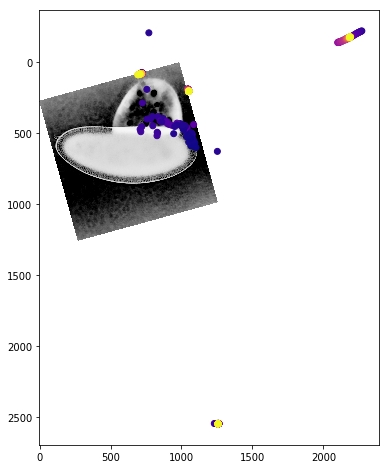

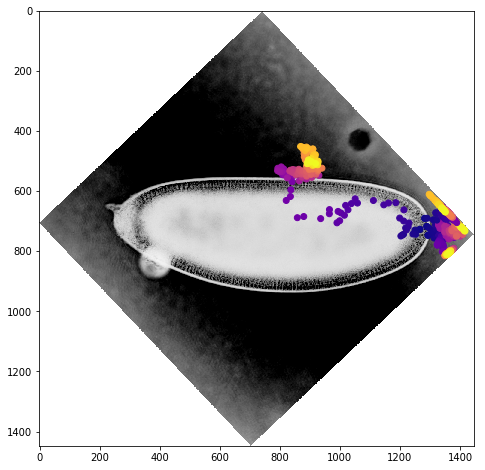

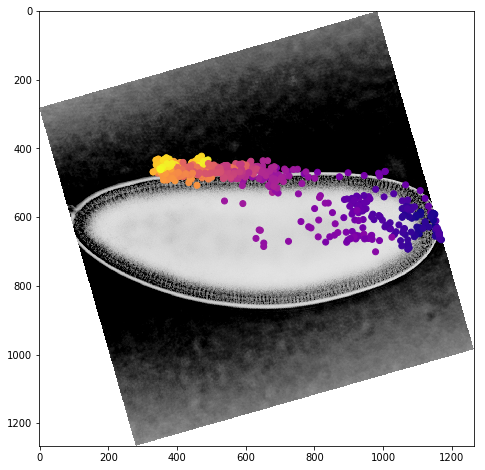

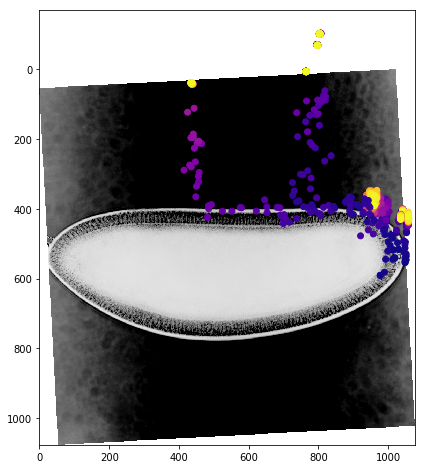

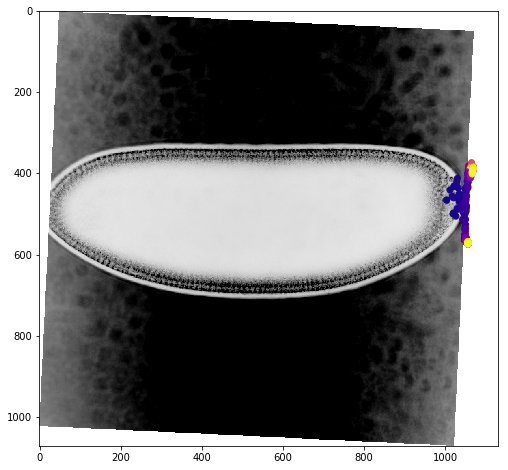

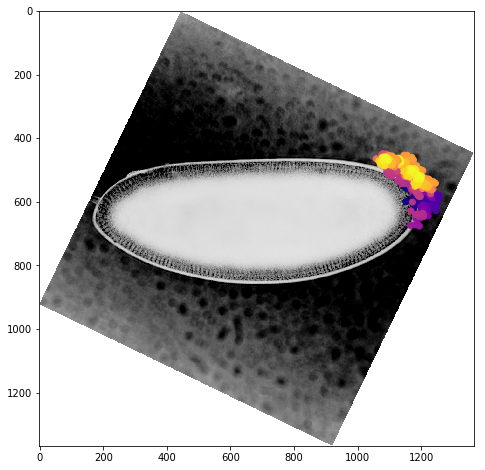

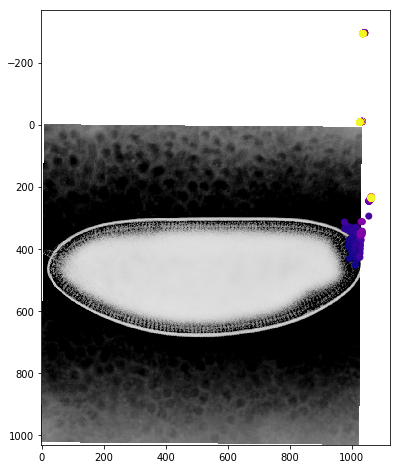

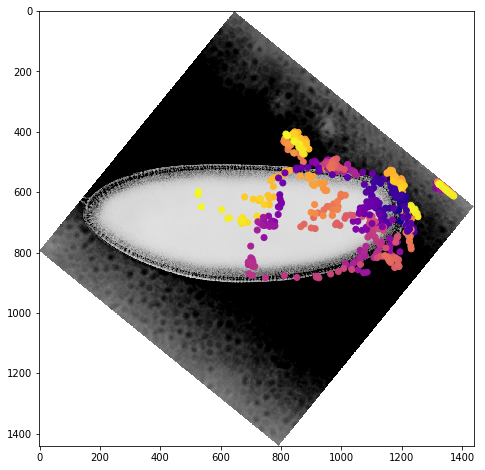

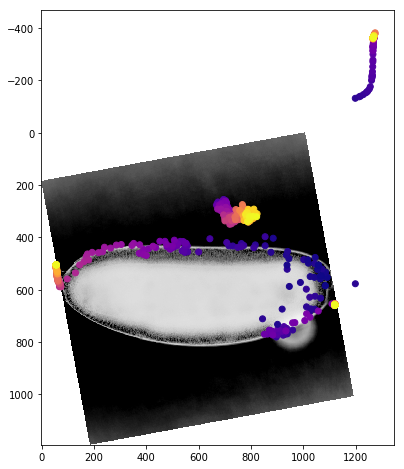

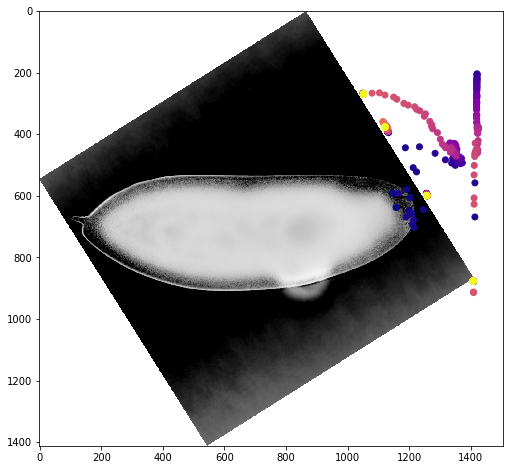

In [29]:
for f in fs:
    fig,ax = plt.subplots(figsize=(10,8))
    ax.imshow(imgs[f][0],cmap='Greys')
    sb = df[df['f']==f]
    ax.scatter(sb.x,sb.y,c=sb['t'].values,cmap='plasma')

# Try loading video data to plot overlay

[Skimage usage example](http://scikit-image.org/docs/dev/user_guide/video.html)
```python 
import av
v = av.open('path/to/video.mov')

for packet in container.demux():
    for frame in packet.decode():
        if frame.type == 'video':
            img = frame.to_image()  # PIL/Pillow image
            arr = np.asarray(img)  # numpy array
            # Do something!
```

From pyav documentation
```python
container = av.open(av.datasets.curated('pexels/time-lapse-video-of-night-sky-857195.mp4'))


# Signal that we only want to look at keyframes.
stream = container.streams.video[0]
stream.codec_context.skip_frame = 'NONKEY'

for frame in container.decode(stream):

    print(frame)

    # We use `frame.pts` as `frame.index` won't make must sense with the `skip_frame`.
    frame.to_image().save(
        'night-sky.{:04d}.jpg'.format(frame.pts),
        quality=80,
    )
```

In [30]:
import av

In [43]:
v = av.open(fs[0]+'.avi')

In [36]:
v.demux()

In [37]:
for packet in v.demux():
    for frame in packet.decode():
        img = frame.to_image()
        arr = np.asarray(img)

deprecated pixel format used, make sure you did set range correctly


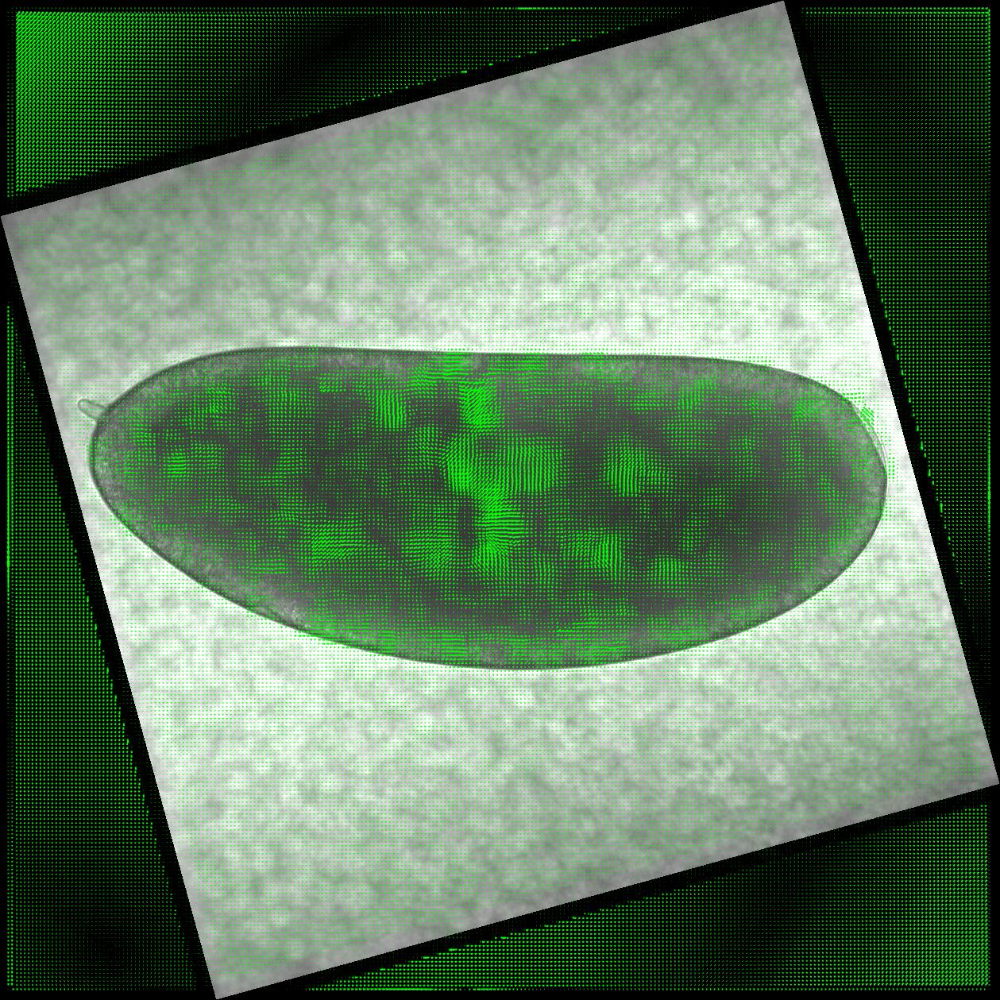

In [39]:
img

In [38]:
arr.shape

(1259, 1259, 3)

In [51]:
arr.min(),arr.max()

(0, 255)

In [48]:
arr.setflags(write=1)

In [52]:
arr[0:100,0:100,0] = 255

In [54]:
arr[100:200,100:200,1] = 255

In [55]:
arr[200:300,200:300,2] = 255

Color order cyan, magenta, yellow

Vectors are encoded in the second channel aka rgb 

In [56]:
bokeh.io.show(bebi103.viz.imshow(arr))

In [44]:
%%time
Larr = []
for packet in v.demux():
    for frame in packet.decode():
        Larr.append(np.asarray(frame.to_image()))

CPU times: user 3.9 s, sys: 671 ms, total: 4.57 s
Wall time: 4.66 s


In [46]:
vimg = np.array(Larr)

In [59]:
vimg.shape

(155, 1259, 1259, 3)

In [58]:
sb = df[df['f']==fs[0]]

In [68]:
d = 20

In [74]:
for i in range(vimg.shape[0]):
    for j in sb['track'].unique():
        trk = sb[sb['track']==j]
        x = int(trk[trk.t==i].x)
        y = int(trk[trk.t==i].y)
        vimg[i,x-d:x+d,y-d:y+d] = [255,0,0]

In [72]:
sb['track'].unique()

array([0, 1, 2, 3])

In [71]:
bokeh.io.show(bebi103.viz.imshow(vimg[100]))